In [ ]:
#Explaining a linear regression model

In [2]:
pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 569 kB 5.3 MB/s 


In [3]:
import pandas as pd
df_lin_reg = pd.read_csv('https://archive.ics.uci.edu/ml/machine-learning-databases/00374/energydata_complete.csv')
del df_lin_reg['date']
df_lin_reg.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 28 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Appliances   19735 non-null  int64  
 1   lights       19735 non-null  int64  
 2   T1           19735 non-null  float64
 3   RH_1         19735 non-null  float64
 4   T2           19735 non-null  float64
 5   RH_2         19735 non-null  float64
 6   T3           19735 non-null  float64
 7   RH_3         19735 non-null  float64
 8   T4           19735 non-null  float64
 9   RH_4         19735 non-null  float64
 10  T5           19735 non-null  float64
 11  RH_5         19735 non-null  float64
 12  T6           19735 non-null  float64
 13  RH_6         19735 non-null  float64
 14  T7           19735 non-null  float64
 15  RH_7         19735 non-null  float64
 16  T8           19735 non-null  float64
 17  RH_8         19735 non-null  float64
 18  T9           19735 non-null  float64
 19  RH_9

In [4]:
df_lin_reg.columns

Index(['Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4',
       'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9',
       'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility',
       'Tdewpoint', 'rv1', 'rv2'],
      dtype='object')

In [5]:
#y is the dependent variable, that we need to predict
y = df_lin_reg.pop('Appliances')
# X is the set of input features
X = df_lin_reg

In [16]:
import pandas as pd
import shap
import sklearn
from sklearn import tree, metrics, model_selection, preprocessing
from IPython.display import Image, display
from sklearn.metrics import confusion_matrix, classification_report


# a simple non linear model initialized
model = tree.DecisionTreeRegressor() # plain tree model

# linear regression model trained
model.fit(X, y)

DecisionTreeRegressor()

[Text(0.5441854071763934, 0.9907407407407407, 'X[0] <= 5.0\nsquared_error = 10510.821\nsamples = 19735\nvalue = 97.695'),
 Text(0.28489998990427684, 0.9722222222222222, 'X[21] <= 70.917\nsquared_error = 8107.973\nsamples = 15252\nvalue = 86.585'),
 Text(0.16057722989167528, 0.9537037037037037, 'X[5] <= 26.943\nsquared_error = 12364.13\nsamples = 4112\nvalue = 115.467'),
 Text(0.09973798855122111, 0.9351851851851852, 'X[5] <= 23.253\nsquared_error = 11680.9\nsamples = 3979\nvalue = 111.737'),
 Text(0.033756831831618414, 0.9166666666666666, 'X[14] <= 27.482\nsquared_error = 8588.778\nsamples = 2354\nvalue = 98.428'),
 Text(0.00651744836879378, 0.8981481481481481, 'X[9] <= 17.495\nsquared_error = 18903.159\nsamples = 313\nvalue = 138.722'),
 Text(0.001349016090098071, 0.8796296296296297, 'X[10] <= 48.862\nsquared_error = 29407.84\nsamples = 26\nvalue = 341.923'),
 Text(0.0009171970438880185, 0.8611111111111112, 'X[12] <= 23.912\nsquared_error = 24052.083\nsamples = 24\nvalue = 317.5'),
 T

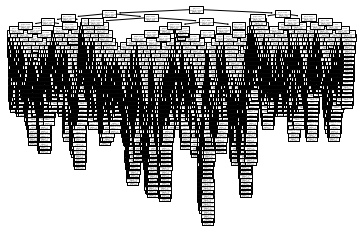

In [17]:
tree.plot_tree(model)

In [18]:
from sklearn.tree import export_text
r = export_text(model,feature_names=list(X.columns))
print(r)

|--- lights <= 5.00
|   |--- RH_out <= 70.92
|   |   |--- T3 <= 26.94
|   |   |   |--- T3 <= 23.25
|   |   |   |   |--- RH_7 <= 27.48
|   |   |   |   |   |--- T5 <= 17.50
|   |   |   |   |   |   |--- RH_5 <= 48.86
|   |   |   |   |   |   |   |--- RH_6 <= 23.91
|   |   |   |   |   |   |   |   |--- RH_1 <= 34.60
|   |   |   |   |   |   |   |   |   |--- value: [610.00]
|   |   |   |   |   |   |   |   |--- RH_1 >  34.60
|   |   |   |   |   |   |   |   |   |--- value: [580.00]
|   |   |   |   |   |   |   |--- RH_6 >  23.91
|   |   |   |   |   |   |   |   |--- T3 <= 21.81
|   |   |   |   |   |   |   |   |   |--- T2 <= 19.31
|   |   |   |   |   |   |   |   |   |   |--- RH_3 <= 36.59
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 3
|   |   |   |   |   |   |   |   |   |   |--- RH_3 >  36.59
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 2
|   |   |   |   |   |   |   |   |   |--- T2 >  19.31
|   |   |   |   |   |   |   |   |   |   |--- T3 <

In [19]:
list(zip(model.feature_importances_,X.columns))

[(0.04755691132990445, 'lights'),
 (0.02729240744739512, 'T1'),
 (0.050990867453263464, 'RH_1'),
 (0.029613682425136578, 'T2'),
 (0.05287817171439917, 'RH_2'),
 (0.03809698118314153, 'T3'),
 (0.04702017020903361, 'RH_3'),
 (0.03833652568783967, 'T4'),
 (0.029168659250593493, 'RH_4'),
 (0.023818050212012467, 'T5'),
 (0.053380938919333785, 'RH_5'),
 (0.03242898742121811, 'T6'),
 (0.036442867206438946, 'RH_6'),
 (0.03272087870063947, 'T7'),
 (0.0459966882745736, 'RH_7'),
 (0.03786926541394416, 'T8'),
 (0.05569343410157808, 'RH_8'),
 (0.03888560547088362, 'T9'),
 (0.03205551180175258, 'RH_9'),
 (0.018209440939872642, 'T_out'),
 (0.04401669364414831, 'Press_mm_hg'),
 (0.06483375260268251, 'RH_out'),
 (0.0343793163965324, 'Windspeed'),
 (0.022764397449413956, 'Visibility'),
 (0.02962771107600761, 'Tdewpoint'),
 (0.023354544387479956, 'rv1'),
 (0.012567539280780866, 'rv2')]

In [22]:
import shap
# compute the SHAP values for the linear model
explainer = shap.TreeExplainer(model)

# SHAP value calculation
shap_values = explainer.shap_values(X)


In [23]:
shap_values

array([[23.36837896, -6.27221443,  5.31114685, ...,  1.10462273,
         1.99443307,  1.1614488 ],
       [18.20936013, -6.75002359,  1.73175632, ...,  0.08660514,
        -7.04122159,  0.3290079 ],
       [17.27247349, -7.32103866,  1.60511757, ..., -0.26053128,
        -6.8897792 , -0.27665881],
       ...,
       [30.96550495, -8.29716891, -9.13070007, ...,  7.92266998,
        -0.80251599, -0.32329425],
       [44.85812126, -4.36728837, 26.54913879, ...,  8.12764973,
         0.83096036,  4.98072248],
       [52.81254445, -3.7868782 , 26.60317326, ...,  7.05304502,
        -0.84167706, -0.37429882]])

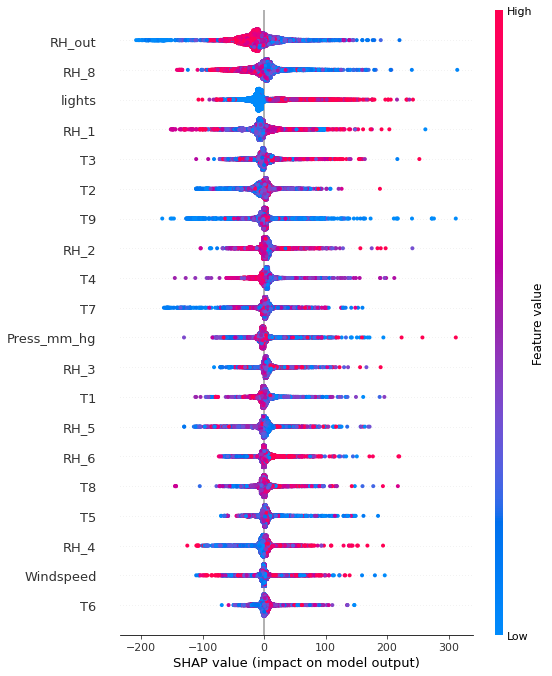

In [24]:
# explain all the predictions in the dataset
shap.summary_plot(shap_values, X)

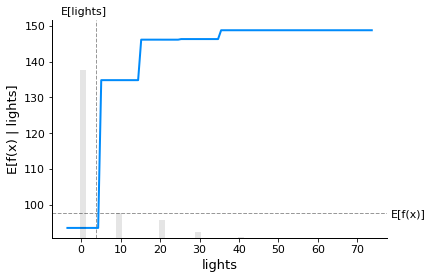

In [25]:
shap.partial_dependence_plot(
    "lights", model.predict, X, ice=False,
    model_expected_value=True, feature_expected_value=True
)

In [ ]:
# non-numeric dataset that has categorical variables

In [28]:
df = pd.read_csv('https://raw.githubusercontent.com/pradmishra1/PublicDatasets/main/automobile.csv')

In [29]:
df.head(3)

,Price,Make,Location,Age,Odometer,FuelType,Transmission,OwnerType,Mileage,EngineCC,PowerBhp
0,1.75,marutiwagonr,Mumbai,10,72000,CNG,Manual,First,26.6,998,58.16
1,12.50,hyundaicreta,Pune,5,41000,Diesel,Manual,First,19.67,1582,126.2
2,4.50,hondajazz,Chennai,9,46000,Petrol,Manual,First,18.2,1199,88.7


In [30]:
df.columns

Index(['Price', 'Make', 'Location', 'Age', 'Odometer', 'FuelType',
       'Transmission', 'OwnerType', 'Mileage', 'EngineCC', 'PowerBhp'],
      dtype='object')

In [31]:
df_t = pd.read_csv('https://raw.githubusercontent.com/pradmishra1/PublicDatasets/main/Automobile_transformed.csv')

In [32]:
del df_t['Unnamed: 0']
df_t.head(3)

,Price,Age,Odometer,mileage,engineCC,powerBhp,Location_Bangalore,Location_Chennai,Location_Coimbatore,Location_Delhi,...,Location_Mumbai,Location_Pune,FuelType_Diesel,FuelType_Electric,FuelType_LPG,FuelType_Petrol,Transmission_Manual,OwnerType_Fourth +ACY- Above,OwnerType_Second,OwnerType_Third
0,1.75,10,72000,26.60,998.0,58.16,0,0,0,0,...,1,0,0,0,0,0,1,0,0,0
1,12.50,5,41000,19.67,1582.0,126.20,0,0,0,0,...,0,1,1,0,0,0,1,0,0,0
2,4.50,9,46000,18.20,1199.0,88.70,0,1,0,0,...,0,0,0,0,0,1,1,0,0,0


In [33]:
df_t.columns

Index(['Price', 'Age', 'Odometer', 'mileage', 'engineCC', 'powerBhp',
       'Location_Bangalore', 'Location_Chennai', 'Location_Coimbatore',
       'Location_Delhi', 'Location_Hyderabad', 'Location_Jaipur',
       'Location_Kochi', 'Location_Kolkata', 'Location_Mumbai',
       'Location_Pune', 'FuelType_Diesel', 'FuelType_Electric', 'FuelType_LPG',
       'FuelType_Petrol', 'Transmission_Manual',
       'OwnerType_Fourth +ACY- Above', 'OwnerType_Second', 'OwnerType_Third'],
      dtype='object')

In [34]:
#y is the dependent variable, that we need to predict
y = df_t.pop('Price')
# X is the set of input features
X = df_t

In [35]:
import pandas as pd
import shap
import sklearn

# a simple non linear model initialized
model = sklearn.tree.DecisionTreeRegressor()

# decision tree regression model trained
model.fit(X, y)

DecisionTreeRegressor()

In [38]:
# compute the SHAP values for the linear model
explainer = shap.Explainer(model)

# SHAP value calculation
shap_values = explainer.shap_values(X)

In [39]:
list(zip(model.feature_importances_,X.columns))

[(0.169576524767871, 'Age'),
 (0.046585658464360816, 'Odometer'),
 (0.04576869739225194, 'mileage'),
 (0.059163321062728785, 'engineCC'),
 (0.6384264191473127, 'powerBhp'),
 (0.002522314313269304, 'Location_Bangalore'),
 (0.0008970034245261699, 'Location_Chennai'),
 (0.003791617161795056, 'Location_Coimbatore'),
 (0.0010761093313731759, 'Location_Delhi'),
 (0.011285026407948304, 'Location_Hyderabad'),
 (0.00020112882138512196, 'Location_Jaipur'),
 (0.0008616198710522111, 'Location_Kochi'),
 (0.0008846931798977568, 'Location_Kolkata'),
 (0.0021470912577561748, 'Location_Mumbai'),
 (0.0007076796376248901, 'Location_Pune'),
 (0.0013274593267184971, 'FuelType_Diesel'),
 (0.0, 'FuelType_Electric'),
 (3.4571613363343374e-07, 'FuelType_LPG'),
 (0.002242358883910862, 'FuelType_Petrol'),
 (0.010550931985109665, 'Transmission_Manual'),
 (8.131243463060016e-07, 'OwnerType_Fourth +ACY- Above'),
 (0.0016721486214358624, 'OwnerType_Second'),
 (0.0003110381011919031, 'OwnerType_Third')]

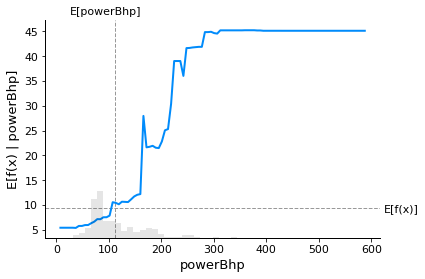

In [40]:
shap.partial_dependence_plot(
    "powerBhp", model.predict, X, ice=False,
    model_expected_value=True, feature_expected_value=True
)

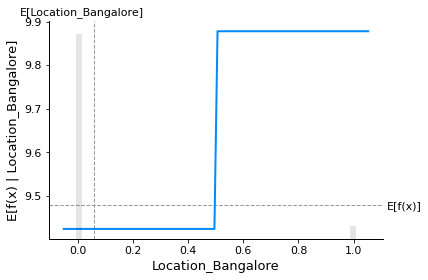

In [41]:
shap.partial_dependence_plot(
    "Location_Bangalore", model.predict, X, ice=False,
    model_expected_value=True, feature_expected_value=True
)

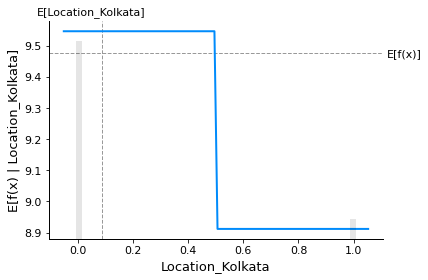

In [42]:
shap.partial_dependence_plot(
    "Location_Kolkata", model.predict, X, ice=False,
    model_expected_value=True, feature_expected_value=True
)

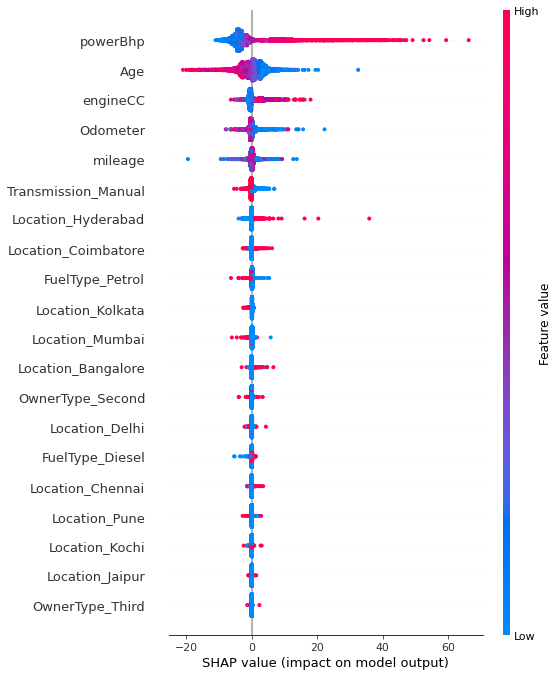

In [46]:
# explain all the predictions in the dataset
shap.summary_plot(shap_values, X)

In [47]:
!pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 275 kB 5.3 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=de76894899a38e95ad086fdaf016c9c9186c7f3779927c1e60f61fd7326b3a34
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime


In [48]:
import lime
import lime.lime_tabular

explainer = lime.lime_tabular.LimeTabularExplainer(np.array(X),
                                                   mode='regression',
                                                  feature_names=X.columns,
                                                  class_names=['price'],
                                                  verbose=True)

In [49]:
explainer.feature_selection

'auto'

In [50]:
# asking for explanation for LIME model
i = 60
exp = explainer.explain_instance(np.array(X)[i],
                                 model.predict, 
                                 num_features=14
                                )


model.predict(X)[60]

X[60:61]

Intercept -6.9881095432071465
Prediction_local [33.29071077]
Right: 16.5


X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names


,Age,Odometer,mileage,engineCC,powerBhp,Location_Bangalore,Location_Chennai,Location_Coimbatore,Location_Delhi,Location_Hyderabad,...,Location_Mumbai,Location_Pune,FuelType_Diesel,FuelType_Electric,FuelType_LPG,FuelType_Petrol,Transmission_Manual,OwnerType_Fourth +ACY- Above,OwnerType_Second,OwnerType_Third
60,3,22000,13.68,2393.0,147.8,0,0,0,0,0,...,1,0,1,0,0,0,1,0,0,0


In [51]:
exp.show_in_notebook(show_table=True)

In [52]:
exp.as_list()

[('powerBhp > 138.10', 19.961371959849174),
 ('FuelType_Electric <= 0.00', 6.836722688525879),
 ('Age <= 4.00', 5.249921722968705),
 ('OwnerType_Fourth +ACY- Above <= 0.00', 3.4582886724264483),
 ('0.00 < Transmission_Manual <= 1.00', -2.9145492368305157),
 ('engineCC > 1984.00', 2.432167151933345),
 ('Odometer <= 34000.00', 1.8038639987179637),
 ('FuelType_LPG <= 0.00', 1.4135278408858953),
 ('OwnerType_Third <= 0.00', 1.3547839120439655),
 ('mileage <= 15.30', 0.8239170366232045),
 ('Location_Kochi <= 0.00', -0.6740434016444569),
 ('Location_Hyderabad <= 0.00', -0.6190270673151664),
 ('Location_Delhi <= 0.00', 0.6091569397933114),
 ('FuelType_Petrol <= 0.00', 0.5427180987401807)]

In [53]:
pip install eli5

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 216 kB 5.1 MB/s 
     |████████████████████████████████| 133 kB 35.5 MB/s 
  Created wheel for eli5: filename=eli5-0.13.0-py2.py3-none-any.whl size=107748 sha256=bd6c2247563254635ac27489b4c033dad185b3a58f5a36c91ef4e295d699860b
  Stored in directory: /root/.cache/pip/wheels/cc/3c/96/3ead31a8e6c20fc0f1a707fde2e05d49a80b1b4b30096573be
Successfully built eli5
  Attempting uninstall: jinja2
    Found existing installation: Jinja2 2.11.3
    Uninstalling Jinja2-2.11.3:
      Successfully uninstalled Jinja2-2.11.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flask 1.1.4 requires Jinja2<3.0,>=2.10.1, but you have jinja2 3.1.2 which is incompatible.


In [54]:
import eli5

In [55]:
eli5.show_weights(model,
                 feature_names=list(X.columns))

Weight,Feature
0.6384,powerBhp
0.1696,Age
0.0592,engineCC
0.0466,Odometer
0.0458,mileage
0.0113,Location_Hyderabad
0.0106,Transmission_Manual
0.0038,Location_Coimbatore
0.0025,Location_Bangalore
0.0022,FuelType_Petrol


In [56]:
eli5.explain_weights(model, feature_names=list(X.columns))

Weight,Feature
0.6384,powerBhp
0.1696,Age
0.0592,engineCC
0.0466,Odometer
0.0458,mileage
0.0113,Location_Hyderabad
0.0106,Transmission_Manual
0.0038,Location_Coimbatore
0.0025,Location_Bangalore
0.0022,FuelType_Petrol


In [57]:
eli5.explain_prediction(model,X.iloc[60])

Explanation(estimator='DecisionTreeRegressor()', description='\nFeatures with largest coefficients.\n\nFeature weights are calculated by following decision paths in trees\nof an ensemble (or a single tree for DecisionTreeClassifier).\nEach node of the tree has an output score, and contribution of a feature\non the decision path is how much the score changes from parent to child.\nWeights of all features sum to the output score or proba of the estimator.\n\nCaveats:\n1. Feature weights just show if the feature contributed positively or\n   negatively to the final score, and does not show how increasing or\n   decreasing the feature value will change the prediction.\n2. In some cases, feature weight can be close to zero for an important feature.\n   For example, in a single tree that computes XOR function, the feature at the\n   top of the tree will have zero weight because expected scores for both\n   branches are equal, so decision at the top feature does not change the\n   expected score. For an ensemble predicting XOR functions it might not be\n   a problem, but it is not reliable if most trees happen to choose the same\n   feature at the top.\n', error=None, method='decision path', is_regression=True, targets=[TargetExplanation(target='y', feature_weights=FeatureWeights(pos=[FeatureWeight(feature='<BIAS>', weight=9.479468350224273, std=None, value=1.0), FeatureWeight(feature='engineCC', weight=4.709719397574098, std=None, value=2393.0), FeatureWeight(feature='Age', weight=4.189934713830057, std=None, value=3.0), FeatureWeight(feature='mileage', weight=1.4671023965141572, std=None, value=13.68), FeatureWeight(feature='FuelType_Petrol', weight=0.7132740740740786, std=None, value=0.0), FeatureWeight(feature='powerBhp', weight=0.6668731970337696, std=None, value=147.8), FeatureWeight(feature='Odometer', weight=0.07142105263158172, std=None, value=22000.0)], neg=[FeatureWeight(feature='Transmission_Manual', weight=-3.4847931818820133, std=None, value=1.0), FeatureWeight(feature='Location_Mumbai', weight=-1.3130000000000024, std=None, value=1.0)], pos_remaining=0, neg_remaining=0), proba=None, score=16.5, weighted_spans=None, heatmap=None)], feature_importances=None, decision_tree=None, highlight_spaces=None, transition_features=None, image=None)

In [58]:
from eli5.sklearn import PermutationImportance

# a simple linear model initialized
model = sklearn.tree.DecisionTreeRegressor()

# linear regression model trained
model.fit(X, y)

DecisionTreeRegressor()

In [59]:
perm = PermutationImportance(model)
perm.fit(X, y)
eli5.show_weights(perm,feature_names=list(X.columns))

Weight,Feature
1.3784 ± 0.0884,powerBhp
0.4245 ± 0.0049,Age
0.2587 ± 0.0120,engineCC
0.1968 ± 0.0333,Odometer
0.1557 ± 0.0103,mileage
0.0709 ± 0.0425,Location_Hyderabad
0.0550 ± 0.0076,Transmission_Manual
0.0120 ± 0.0037,FuelType_Petrol
0.0095 ± 0.0011,Location_Coimbatore
0.0086 ± 0.0015,FuelType_Diesel


In [ ]:
### Explaining a linear logistic regression model

In [80]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn import tree, metrics, model_selection, preprocessing
from sklearn.metrics import confusion_matrix, classification_report

df_train = pd.read_csv('https://raw.githubusercontent.com/pradmishra1/PublicDatasets/main/ChurnData_test.csv')

In [81]:
from sklearn.preprocessing import LabelEncoder

tras = LabelEncoder()
df_train['area_code_tr'] = tras.fit_transform(df_train['area_code'])
df_train.columns
del df_train['area_code']
df_train.columns
df_train['target_churn_dum'] = pd.get_dummies(df_train.churn,prefix='churn',drop_first=True)
df_train.columns
del df_train['international_plan']
del df_train['voice_mail_plan']
del df_train['churn']
df_train.info()
del df_train['Unnamed: 0']
df_train.columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1667 entries, 0 to 1666
Data columns (total 19 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Unnamed: 0                     1667 non-null   int64  
 1   state                          1667 non-null   object 
 2   account_length                 1667 non-null   int64  
 3   number_vmail_messages          1667 non-null   int64  
 4   total_day_minutes              1667 non-null   float64
 5   total_day_calls                1667 non-null   int64  
 6   total_day_charge               1667 non-null   float64
 7   total_eve_minutes              1667 non-null   float64
 8   total_eve_calls                1667 non-null   int64  
 9   total_eve_charge               1667 non-null   float64
 10  total_night_minutes            1667 non-null   float64
 11  total_night_calls              1667 non-null   int64  
 12  total_night_charge             1667 non-null   f

Index(['state', 'account_length', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'area_code_tr', 'target_churn_dum'],
      dtype='object')

In [82]:
df_train.columns

Index(['state', 'account_length', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'area_code_tr', 'target_churn_dum'],
      dtype='object')

In [83]:
from sklearn.model_selection import train_test_split

df_train.columns

X = df_train[['account_length', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'area_code_tr']]
Y = df_train['target_churn_dum']

In [84]:
xtrain,xtest,ytrain,ytest=train_test_split(X,Y,test_size=0.20,stratify=Y)
tree_model = tree.DecisionTreeClassifier()

tree_model.fit(xtrain,ytrain)

print("training accuracy:", tree_model.score(xtrain,ytrain)) #training accuracy

print("test accuracy:",tree_model.score(xtest,ytest)) # test accuracy

training accuracy: 1.0
test accuracy: 0.8562874251497006


In [85]:
# Provide Probability as Output
def model_churn_proba(x):
    return tree_model.predict_proba(x)[:,1]

# Provide Log Odds as Output
def model_churn_log_odds(x):
    p = tree_model.predict_log_proba(x)
    return p[:,1] - p[:,0]

In [86]:
# compute the SHAP values for the linear model
background_churn = shap.maskers.Independent(X, max_samples=500)
explainer = shap.Explainer(tree_model, background_churn,feature_names=list(X.columns))
shap_values_churn = explainer(X)

In [87]:
shap_values_churn

.values =
array([[[ 1.38333371e-03, -1.38333329e-03],
        [-1.52000001e-02,  1.52000002e-02],
        [ 1.35480951e-01, -1.35480953e-01],
        ...,
        [-3.76666622e-03,  3.76666675e-03],
        [ 4.69571433e-02, -4.69571423e-02],
        [ 0.00000000e+00,  0.00000000e+00]],

       [[ 5.13333347e-03, -5.13333342e-03],
        [-9.87857099e-03,  9.87857173e-03],
        [ 4.12833317e-02, -4.12833335e-02],
        ...,
        [ 6.42857321e-04, -6.42857147e-04],
        [ 1.65785710e-02, -1.65785717e-02],
        [ 1.10000005e-03, -1.10000005e-03]],

       [[-3.38095289e-04,  3.38095304e-04],
        [ 3.84364282e-01, -3.84364291e-01],
        [-1.24673826e-01,  1.24673804e-01],
        ...,
        [-3.04762205e-04,  3.04761922e-04],
        [ 7.14047672e-03, -7.14047646e-03],
        [-1.20000002e-03,  1.20000002e-03]],

       ...,

       [[ 1.61904640e-04, -1.61904626e-04],
        [-1.06428568e-02,  1.06428575e-02],
        [-1.03166681e-02,  1.03166662e-02],
        

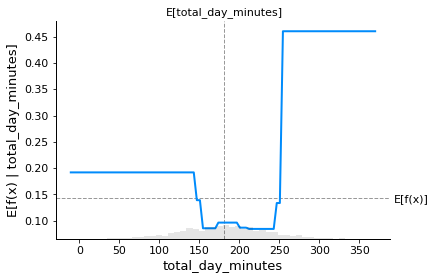

In [88]:
# make a standard partial dependence plot
sample_ind = 25
fig,ax = shap.partial_dependence_plot(
    "total_day_minutes", model_churn_proba, X, model_expected_value=True,
    feature_expected_value=True, show=False, ice=False
)

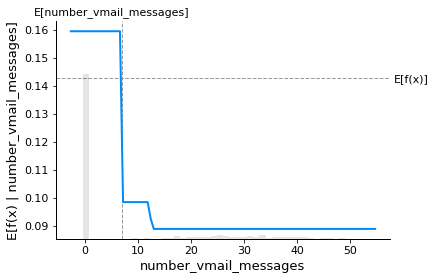

In [89]:
# make a standard partial dependence plot
sample_ind = 25
fig,ax = shap.partial_dependence_plot(
    "number_vmail_messages", model_churn_proba, X, model_expected_value=True,
    feature_expected_value=True, show=False,ice=False)

In [90]:
# compute the SHAP values for the linear model
explainer_log_odds = shap.Explainer(tree_model, background_churn,feature_names=list(X.columns))
shap_values_churn_log_odds = explainer_log_odds(X)
shap_values_churn_log_odds

.values =
array([[[ 1.38333371e-03, -1.38333329e-03],
        [-1.52000001e-02,  1.52000002e-02],
        [ 1.35480951e-01, -1.35480953e-01],
        ...,
        [-3.76666622e-03,  3.76666675e-03],
        [ 4.69571433e-02, -4.69571423e-02],
        [ 0.00000000e+00,  0.00000000e+00]],

       [[ 5.13333347e-03, -5.13333342e-03],
        [-9.87857099e-03,  9.87857173e-03],
        [ 4.12833317e-02, -4.12833335e-02],
        ...,
        [ 6.42857321e-04, -6.42857147e-04],
        [ 1.65785710e-02, -1.65785717e-02],
        [ 1.10000005e-03, -1.10000005e-03]],

       [[-3.38095289e-04,  3.38095304e-04],
        [ 3.84364282e-01, -3.84364291e-01],
        [-1.24673826e-01,  1.24673804e-01],
        ...,
        [-3.04762205e-04,  3.04761922e-04],
        [ 7.14047672e-03, -7.14047646e-03],
        [-1.20000002e-03,  1.20000002e-03]],

       ...,

       [[ 1.61904640e-04, -1.61904626e-04],
        [-1.06428568e-02,  1.06428575e-02],
        [-1.03166681e-02,  1.03166662e-02],
        

In [110]:
temp_df = pd.DataFrame()
temp_df['Feature Name'] = pd.Series(X.columns)
temp_df['Importance'] = pd.Series(tree_model.feature_importances_)
temp_df.sort_values(by='Importance',ascending=False)

,Feature Name,Importance
2,total_day_minutes,0.219502
14,number_customer_service_calls,0.120392
4,total_day_charge,0.097044
7,total_eve_charge,0.095221
1,number_vmail_messages,0.062609
10,total_night_charge,0.061233
8,total_night_minutes,0.057162
9,total_night_calls,0.055642
11,total_intl_minutes,0.046794
3,total_day_calls,0.043435


In [93]:
import lime
import lime.lime_tabular

explainer = lime.lime_tabular.LimeTabularExplainer(np.array(xtrain),
                    feature_names=list(xtrain.columns), 
                    class_names=['target_churn_dum'], 
                    verbose=True, mode='classification')

In [95]:
# this record is a no churn scenario
exp = explainer.explain_instance(xtest.iloc[0], tree_model.predict_proba, num_features=16)
exp.as_list()

Intercept 0.17857751096606778
Prediction_local [0.16068057]
Right: 1.0


X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


[('total_day_minutes > 215.90', 0.1362643566581409),
 ('number_vmail_messages <= 0.00', 0.0929673100640601),
 ('3.00 < total_intl_calls <= 4.00', -0.05389996557257846),
 ('total_day_calls <= 86.00', -0.051572104790178076),
 ('99.00 < total_night_calls <= 112.00', -0.046773114913399146),
 ('1.00 < number_customer_service_calls <= 2.00', -0.04441521857295649),
 ('total_intl_charge <= 2.32', -0.02367171273632465),
 ('200.40 < total_eve_minutes <= 232.60', -0.01768355201942605),
 ('8.95 < total_night_charge <= 10.40', -0.016767719469372562),
 ('88.00 < total_eve_calls <= 101.00', -0.015113160995228619),
 ('total_day_charge > 36.70', 0.01338384802674405),
 ('area_code_tr > 1.00', 0.006774852953278585),
 ('total_intl_minutes <= 8.60', 0.005598720978761775),
 ('17.03 < total_eve_charge <= 19.77', -0.0036223084182909603),
 ('98.00 < account_length <= 126.00', 0.0006345376072269405),
 ('198.80 < total_night_minutes <= 231.20', -1.7083964912392244e-06)]

In [97]:
pd.DataFrame(exp.as_list())

,0,1
0,total_day_minutes > 215.90,0.136264
1,number_vmail_messages <= 0.00,0.092967
2,3.00 < total_intl_calls <= 4.00,-0.053900
3,total_day_calls <= 86.00,-0.051572
4,99.00 < total_night_calls <= 112.00,-0.046773
5,1.00 < number_customer_service_calls <= 2.00,-0.044415
6,total_intl_charge <= 2.32,-0.023672
7,200.40 < total_eve_minutes <= 232.60,-0.017684
8,8.95 < total_night_charge <= 10.40,-0.016768
9,88.00 < total_eve_calls <= 101.00,-0.015113


In [98]:
exp.show_in_notebook(show_table=True)

In [99]:
# This is s churn scenario
exp = explainer.explain_instance(xtest.iloc[20], tree_model.predict_proba, num_features=16)
exp.as_list()

Intercept 0.10256094438264549
Prediction_local [0.42951224]
Right: 1.0


X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


[('number_vmail_messages <= 0.00', 0.1251461520949672),
 ('number_customer_service_calls <= 1.00', -0.11471932451025148),
 ('total_day_minutes > 215.90', 0.11335292810078498),
 ('total_intl_calls <= 3.00', 0.0833975606666818),
 ('total_eve_charge > 19.77', 0.07087970621129276),
 ('total_day_charge > 36.70', 0.044322021446899056),
 ('total_night_calls <= 86.00', 0.03835204203269277),
 ('10.40 < total_intl_minutes <= 12.00', -0.028762467921123958),
 ('total_eve_calls <= 88.00', 0.027744744266104262),
 ('198.80 < total_night_minutes <= 231.20', -0.014434614677050405),
 ('8.95 < total_night_charge <= 10.40', -0.01246344270348464),
 ('86.00 < total_day_calls <= 99.00', 0.012186288614633462),
 ('73.00 < account_length <= 98.00', -0.011046720698750234),
 ('0.00 < area_code_tr <= 1.00', -0.010595644578095056),
 ('2.81 < total_intl_charge <= 3.24', 0.0033945972331523373),
 ('total_eve_minutes > 232.60', 0.0001974706449185791)]

In [100]:
exp.show_in_notebook(show_table=True)

In [101]:
eli5.show_weights(tree_model,
                 feature_names=list(xtrain.columns))

Weight,Feature
0.2195,total_day_minutes
0.1204,number_customer_service_calls
0.0970,total_day_charge
0.0952,total_eve_charge
0.0626,number_vmail_messages
0.0612,total_night_charge
0.0572,total_night_minutes
0.0556,total_night_calls
0.0468,total_intl_minutes
0.0434,total_day_calls


In [102]:
eli5.explain_weights(tree_model, feature_names=list(xtrain.columns))

Weight,Feature
0.2195,total_day_minutes
0.1204,number_customer_service_calls
0.0970,total_day_charge
0.0952,total_eve_charge
0.0626,number_vmail_messages
0.0612,total_night_charge
0.0572,total_night_minutes
0.0556,total_night_calls
0.0468,total_intl_minutes
0.0434,total_day_calls


In [103]:
eli5.explain_prediction(tree_model,xtrain.iloc[60])

Explanation(estimator='DecisionTreeClassifier()', description='\nFeatures with largest coefficients.\n\nFeature weights are calculated by following decision paths in trees\nof an ensemble (or a single tree for DecisionTreeClassifier).\nEach node of the tree has an output score, and contribution of a feature\non the decision path is how much the score changes from parent to child.\nWeights of all features sum to the output score or proba of the estimator.\n\nCaveats:\n1. Feature weights just show if the feature contributed positively or\n   negatively to the final score, and does not show how increasing or\n   decreasing the feature value will change the prediction.\n2. In some cases, feature weight can be close to zero for an important feature.\n   For example, in a single tree that computes XOR function, the feature at the\n   top of the tree will have zero weight because expected scores for both\n   branches are equal, so decision at the top feature does not change the\n   expected score. For an ensemble predicting XOR functions it might not be\n   a problem, but it is not reliable if most trees happen to choose the same\n   feature at the top.\n', error=None, method='decision path', is_regression=False, targets=[TargetExplanation(target=0, feature_weights=FeatureWeights(pos=[FeatureWeight(feature='<BIAS>', weight=0.8657164291072769, std=None, value=1.0), FeatureWeight(feature='total_eve_charge', weight=0.12551201275004842, std=None, value=14.25), FeatureWeight(feature='total_night_charge', weight=0.11820728291316518, std=None, value=9.14), FeatureWeight(feature='total_night_calls', weight=0.07603686635944695, std=None, value=84.0), FeatureWeight(feature='total_day_minutes', weight=0.037828500818526956, std=None, value=180.2), FeatureWeight(feature='number_customer_service_calls', weight=0.03150845085711429, std=None, value=2.0), FeatureWeight(feature='total_intl_calls', weight=0.010180995475113197, std=None, value=5.0)], neg=[FeatureWeight(feature='total_intl_minutes', weight=-0.09328122888418389, std=None, value=14.6), FeatureWeight(feature='total_day_calls', weight=-0.08804126827766523, std=None, value=97.0), FeatureWeight(feature='total_eve_calls', weight=-0.08366804111884274, std=None, value=47.0)], pos_remaining=0, neg_remaining=0), proba=1.0, score=None, weighted_spans=None, heatmap=None)], feature_importances=None, decision_tree=None, highlight_spaces=None, transition_features=None, image=None)

In [104]:
from eli5.sklearn import PermutationImportance

In [105]:
perm = PermutationImportance(tree_model)
perm.fit(xtest, ytest)
eli5.show_weights(perm,feature_names=list(xtrain.columns))

Weight,Feature
0.0814 ± 0.0272,total_day_minutes
0.0407 ± 0.0188,number_customer_service_calls
0.0359 ± 0.0085,total_eve_charge
0.0299 ± 0.0147,total_night_minutes
0.0263 ± 0.0198,total_night_charge
0.0210 ± 0.0126,number_vmail_messages
0.0174 ± 0.0088,total_day_charge
0.0042 ± 0.0061,total_intl_charge
0.0036 ± 0.0167,total_intl_minutes
0.0006 ± 0.0024,area_code_tr
